In [29]:
import pandas as pd
DATA_DIR = "olist"  # point to your CSV folder

# Load
orders = pd.read_csv(f"{DATA_DIR}/olist_orders_dataset.csv",
                     dtype={"order_id":"string","customer_id":"string"},
                     parse_dates=["order_purchase_timestamp","order_approved_at",
                                  "order_delivered_carrier_date","order_delivered_customer_date",
                                  "order_estimated_delivery_date"])
order_items = pd.read_csv(f"{DATA_DIR}/olist_order_items_dataset.csv",
                          dtype={"order_id":"string","product_id":"string","seller_id":"string"})
payments = pd.read_csv(f"{DATA_DIR}/olist_order_payments_dataset.csv",
                       dtype={"order_id":"string"})
reviews = pd.read_csv(f"{DATA_DIR}/olist_order_reviews_dataset.csv",
                      dtype={"order_id":"string"},
                      parse_dates=["review_creation_date","review_answer_timestamp"])
customers = pd.read_csv(f"{DATA_DIR}/olist_customers_dataset.csv",
                        dtype={"customer_id":"string","customer_unique_id":"string"})
geolocation = pd.read_csv(f"{DATA_DIR}/olist_geolocation_dataset.csv")
sellers = pd.read_csv(f"{DATA_DIR}/olist_sellers_dataset.csv")
# Aggregations
pay_agg = payments.groupby("order_id", as_index=False).agg(
    payment_value=("payment_value","sum"),
    payment_installments=("payment_installments","max")
)
rev_agg = reviews.groupby("order_id", as_index=False).agg(
    review_score=("review_score","mean"),
    reviews_count=("review_id","count")
)

# Build order-level frame
orders_enriched = (orders
    .merge(customers, on="customer_id", how="left")
    .merge(pay_agg, on="order_id", how="left")
    .merge(rev_agg, on="order_id", how="left")
)

# Convenience columns
orders_enriched["purchase_month"] = orders_enriched["order_purchase_timestamp"].dt.to_period("M").dt.to_timestamp()
orders_enriched["delivered_days"] = (orders_enriched["order_delivered_customer_date"] - orders_enriched["order_purchase_timestamp"]).dt.days
orders_enriched["delay_days"] = (orders_enriched["order_delivered_customer_date"] - orders_enriched["order_estimated_delivery_date"]).dt.days


In [4]:
!pip install "numpy<2" --force-reinstall

  Using cached numpy-1.26.4-cp312-cp312-win_amd64.whl.metadata (61 kB)
   ---------------------------------------- 0.0/15.5 MB ? eta -:--:--
   ---------------------------------------- 0.0/15.5 MB ? eta -:--:--
   ---------------------------------------- 0.0/15.5 MB ? eta -:--:--
    --------------------------------------- 0.3/15.5 MB ? eta -:--:--
    --------------------------------------- 0.3/15.5 MB ? eta -:--:--
   -- ------------------------------------- 0.8/15.5 MB 1.1 MB/s eta 0:00:14
   --- ------------------------------------ 1.3/15.5 MB 1.4 MB/s eta 0:00:11
   ---- ----------------------------------- 1.6/15.5 MB 1.6 MB/s eta 0:00:09
   ---- ----------------------------------- 1.6/15.5 MB 1.6 MB/s eta 0:00:09
   ---- ----------------------------------- 1.6/15.5 MB 1.6 MB/s eta 0:00:09
   ---- ----------------------------------- 1.6/15.5 MB 1.6 MB/s eta 0:00:09
   ---- ----------------------------------- 1.6/15.5 MB 1.6 MB/s eta 0:00:09
   ---- --------------------------------

  You can safely remove it manually.
  You can safely remove it manually.
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
pandas-ta 0.4.71b0 requires numpy>=2.2.6, but you have numpy 1.26.4 which is incompatible.


In [7]:
state_mix = (orders_enriched
             .groupby("customer_state", as_index=False)
             .agg(orders=("order_id","nunique"),
                  customers=("customer_unique_id","nunique"),
                  gmv=("payment_value","sum"))
            ).sort_values("orders", ascending=False)

city_top = (orders_enriched
            .groupby("customer_city", as_index=False)
            .agg(orders=("order_id","nunique"),
                 customers=("customer_unique_id","nunique"),
                 gmv=("payment_value","sum"))
           ).sort_values("orders", ascending=False).head(25)

geo_trend = (orders_enriched
             .groupby(["purchase_month","customer_state"], as_index=False)
             .agg(orders=("order_id","nunique"),
                  gmv=("payment_value","sum")))


In [8]:
cust_orders = (orders_enriched
               .groupby("customer_unique_id", as_index=False)
               .agg(orders=("order_id","nunique"),
                    first_purchase=("order_purchase_timestamp","min"),
                    last_purchase=("order_purchase_timestamp","max"),
                    gmv=("payment_value","sum")))

repeat_rate = (cust_orders["orders"]>1).mean()

# Cohorts
orders_enriched["order_month"] = orders_enriched["order_purchase_timestamp"].dt.to_period("M").dt.to_timestamp()
firsts = (orders_enriched.groupby("customer_unique_id", as_index=False)
          .agg(first_purchase=("order_month","min")))
cohort = orders_enriched.merge(firsts, on="customer_unique_id", how="left")
cohort["cohort_index"] = ((cohort["order_month"].dt.year - cohort["first_purchase"].dt.year)*12 +
                          (cohort["order_month"].dt.month - cohort["first_purchase"].dt.month))
retention = (cohort.groupby(["first_purchase","cohort_index"])["customer_unique_id"]
             .nunique().reset_index(name="customers"))
base = retention.query("cohort_index==0")[["first_purchase","customers"]].rename(columns={"customers":"cohort_size"})
retention = retention.merge(base, on="first_purchase", how="left")
retention["retention"] = retention["customers"]/retention["cohort_size"]


In [9]:
exp_metrics = (orders_enriched
               .groupby("customer_unique_id", as_index=False)
               .agg(avg_review=("review_score","mean"),
                    avg_delay=("delay_days","mean"),
                    orders=("order_id","nunique")))
corr = exp_metrics[["avg_review","avg_delay","orders"]].corr()


In [10]:
snapshot_date = orders_enriched["order_purchase_timestamp"].max() + pd.Timedelta(days=1)
rfm = (orders_enriched.groupby("customer_unique_id", as_index=False)
       .agg(
           recency_days=("order_purchase_timestamp", lambda s: (snapshot_date - s.max()).days),
           frequency=("order_id","nunique"),
           monetary=("payment_value","sum")
       ))
rfm["R_score"] = pd.qcut(-rfm["recency_days"], 5, labels=[5,4,3,2,1]).astype(int)
rfm["F_score"] = pd.qcut(rfm["frequency"].rank(method="first"), 5, labels=[1,2,3,4,5]).astype(int)
rfm["M_score"] = pd.qcut(rfm["monetary"].rank(method="first"), 5, labels=[1,2,3,4,5]).astype(int)
rfm["RFM_score"] = rfm["R_score"] + rfm["F_score"] + rfm["M_score"]


In [11]:
monthly = (orders_enriched.drop_duplicates("order_id")
           .groupby("purchase_month", as_index=False)
           .agg(
               orders=("order_id","nunique"),
               gmv=("payment_value","sum"),
               a_review=("review_score","mean"),
               cancel_rate=("order_status", lambda s: (s=="canceled").mean()),
               avg_delivered_days=("delivered_days","mean"),
               avg_delay_days=("delay_days","mean")
           ))
monthly["aov"] = monthly["gmv"]/monthly["orders"]


In [23]:
import pandas as pd
import numpy as np
import folium
from folium.plugins import HeatMap
import plotly.express as px


# Merge customer ZIP with lat/lon
geo = geolocation.groupby('geolocation_zip_code_prefix')[['geolocation_lat','geolocation_lng']].mean().reset_index()
customers_geo = customers.merge(geo, left_on='customer_zip_code_prefix', right_on='geolocation_zip_code_prefix', how='left')

# Merge with orders + reviews
orders = orders.merge(customers_geo, on='customer_id', how='left')
orders = orders.merge(reviews[['order_id','review_score']], on='order_id', how='left')

# Compute delivery time in days
orders['order_purchase_timestamp'] = pd.to_datetime(orders['order_purchase_timestamp'])
orders['order_delivered_customer_date'] = pd.to_datetime(orders['order_delivered_customer_date'])
orders['delivery_time_days'] = (orders['order_delivered_customer_date'] - orders['order_purchase_timestamp']).dt.days

# Drop invalid or missing values
orders = orders.dropna(subset=['delivery_time_days','geolocation_lat','geolocation_lng'])
orders = orders[orders['delivery_time_days'] >= 0]


In [19]:
!pip install pandas geopandas folium plotly


   ---------------------------------------- 0.0/19.2 MB ? eta -:--:--
   ------------ --------------------------- 5.8/19.2 MB 32.0 MB/s eta 0:00:01
   --------------------------- ------------ 13.4/19.2 MB 36.5 MB/s eta 0:00:01
   ---------------------------------------- 19.2/19.2 MB 36.8 MB/s eta 0:00:00
   ---------------------------------------- 0.0/6.3 MB ? eta -:--:--
   ---------------------------------------- 6.3/6.3 MB 38.5 MB/s eta 0:00:00
   ---------------------------------------- 0.0/1.7 MB ? eta -:--:--
   ---------------------------------------- 1.7/1.7 MB 31.1 MB/s eta 0:00:00


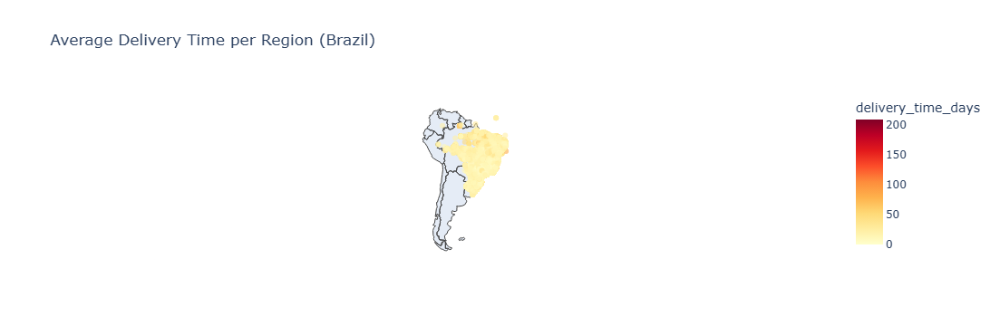

In [24]:
# Average delivery time per state
region_delivery = orders.groupby('customer_state')['delivery_time_days'].mean().reset_index()

# Simple scatter-style map using Plotly
fig = px.scatter_geo(
    orders,
    lat='geolocation_lat',
    lon='geolocation_lng',
    color='delivery_time_days',
    color_continuous_scale='YlOrRd',
    hover_name='customer_city',
    title='Average Delivery Time per Region (Brazil)',
    opacity=0.6
)
fig.update_layout(geo_scope='south america')
fig.show()


In [26]:
# Define cancellation as missing delivery date or status != delivered
orders['is_canceled'] = orders['order_status'] != 'delivered'
cancel_df = orders[orders['is_canceled'] == True]

# Base map centered roughly on Brazil
m = folium.Map(location=[-14.2350, -51.9253], zoom_start=4, tiles='CartoDB positron')

# Add cancellation density as a heatmap
heat_data = cancel_df[['geolocation_lat','geolocation_lng']].dropna().values.tolist()
HeatMap(heat_data, radius=8, blur=10).add_to(m)

m.save("cancel_density_heatmap.html")
m


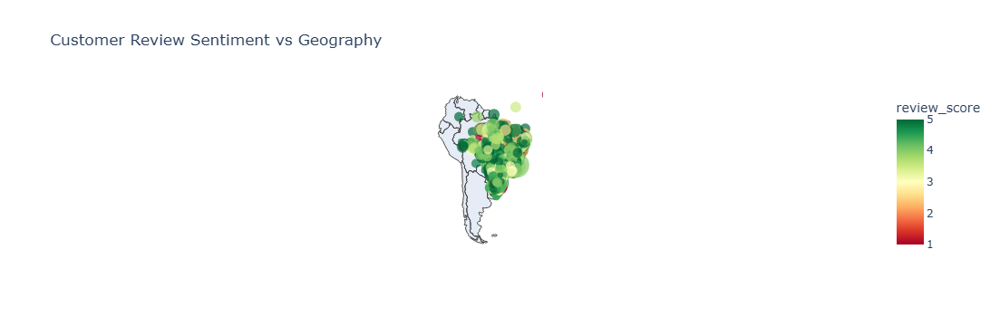

In [27]:
# Map review score (1-5) to sentiment
orders['sentiment'] = orders['review_score'].apply(lambda x: 'Low' if x<=2 else ('Medium' if x==3 else 'High'))

# Aggregate by city for average review and delivery time
city_summary = orders.groupby(['customer_city'])[['review_score','geolocation_lat','geolocation_lng','delivery_time_days']].mean().reset_index()

fig = px.scatter_geo(
    city_summary,
    lat='geolocation_lat',
    lon='geolocation_lng',
    color='review_score',
    size='delivery_time_days',
    hover_name='customer_city',
    color_continuous_scale='RdYlGn',
    projection='natural earth',
    title='Customer Review Sentiment vs Geography'
)
fig.update_traces(marker=dict(sizemode='area', line=dict(width=0)))
fig.update_layout(geo_scope='south america')
fig.show()


In [31]:
sellers_geo = sellers.merge(geo, left_on='seller_zip_code_prefix', right_on='geolocation_zip_code_prefix', how='left')

routes = order_items.merge(orders[['order_id','geolocation_lat','geolocation_lng']], on='order_id')
routes = routes.merge(sellers_geo[['seller_id','geolocation_lat','geolocation_lng']], on='seller_id', suffixes=('_cust','_seller'))

# Sample for visualization (to avoid overcrowding)
sample_routes = routes.sample(500)

m_routes = folium.Map(location=[-14.2350, -51.9253], zoom_start=4, tiles='Stamen TonerLite')

for _, row in sample_routes.iterrows():
    points = [(row['geolocation_lat_seller'], row['geolocation_lng_seller']),
              (row['geolocation_lat_cust'], row['geolocation_lng_cust'])]
    folium.PolyLine(points, color="blue", weight=1, opacity=0.3).add_to(m_routes)

m_routes.save("seller_customer_routes.html")
m_routes


KeyError: "['geolocation_lat', 'geolocation_lng'] not in index"

In [32]:
print(orders.columns)

Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date'],
      dtype='object')


In [33]:
customers_geo = customers.merge(
    geo,
    left_on='customer_zip_code_prefix',
    right_on='geolocation_zip_code_prefix',
    how='left'
).rename(columns={'geolocation_lat':'customer_lat','geolocation_lng':'customer_lng'})

orders = orders.merge(customers_geo[['customer_id','customer_lat','customer_lng']], on='customer_id', how='left')


In [34]:
sellers_geo = sellers.merge(
    geo,
    left_on='seller_zip_code_prefix',
    right_on='geolocation_zip_code_prefix',
    how='left'
).rename(columns={'geolocation_lat':'seller_lat','geolocation_lng':'seller_lng'})


In [35]:
routes = order_items.merge(
    orders[['order_id','customer_lat','customer_lng']],
    on='order_id',
    how='left'
)
routes = routes.merge(
    sellers_geo[['seller_id','seller_lat','seller_lng']],
    on='seller_id',
    how='left'
)


In [36]:
import folium
from folium.plugins import HeatMap

# Sample routes to avoid overcrowding
sample_routes = routes.sample(500)

m_routes = folium.Map(location=[-14.2350, -51.9253], zoom_start=4, tiles='Stamen TonerLite')

for _, row in sample_routes.iterrows():
    points = [(row['seller_lat'], row['seller_lng']),
              (row['customer_lat'], row['customer_lng'])]
    folium.PolyLine(points, color="blue", weight=1, opacity=0.3).add_to(m_routes)

m_routes.save("seller_customer_routes.html")
m_routes


ValueError: Location values cannot contain NaNs.

In [37]:
# Keep only rows where all coordinates are valid
routes_clean = routes.dropna(subset=['seller_lat','seller_lng','customer_lat','customer_lng'])


In [38]:
sample_routes = routes_clean.sample(min(500, len(routes_clean)))  # avoid overcrowding


In [40]:
import folium

# Center the map roughly at Brazil's geographic center
mean_lat = routes_clean[['seller_lat','customer_lat']].stack().mean()
mean_lng = routes_clean[['seller_lng','customer_lng']].stack().mean()

m_routes = folium.Map(location=[mean_lat, mean_lng], zoom_start=5, tiles='Stamen TonerLite')

# Draw lines for each seller->customer route
for _, row in sample_routes.iterrows():
    points = [(row['seller_lat'], row['seller_lng']),
              (row['customer_lat'], row['customer_lng'])]
    folium.PolyLine(points, color="blue", weight=1, opacity=0.3).add_to(m_routes)

# Save and display
m_routes.save("seller_customer_routes.html")
m_routes
